# Deep learning for NLP : Joint text and image representations
## Autors : OLLIER Guillaume, CASALÉ Balthazar, LAMOTHE Charly

In [24]:
%load_ext autoreload
%autoreload 2

## Import

In [1]:
import os
import sys
sys.path.append('..' + os.sep + 'src')

We import the module we will used.

In [25]:
# We ignore the warnings
import warnings
warnings.filterwarnings('ignore')

# We import matplotlib to display the images and other plots
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

from IPython.display import Image

import numpy as np
from keras.models import load_model
from keras.applications.resnet50 import ResNet50

from project_paths import ProjectPaths
from representation.text_representation import TextRepresentation
from representation.image_representation import ImageRepresentation
from model.trainer import Trainer
from model.model_builder import ModelBuilder
from retreival.caption_retreival import CaptionRetreival
from retreival.image_retreival import ImageRetreival
from tsne.tsne_image_2d_scatter import TSNEImage2DScatter
from tsne.tsne_caption_2d_scatter import TSNECaption2DScatter
from tsne.tsne_caption_3d_scatter import TSNECaption3DScatter
from tsne.tsne_image_caption_2d_scatter import TSNEImageCaption2DScatter

In [3]:
ProjectPaths.update_datasets_path('..' + os.sep + 'datasets') # Indicates the path of the datasets

We define the function `plot_image_array()` allowing to display the images with/without the related sentences.

In [4]:
def plot_image_array(path, names, captions=None, columns=5):
    images = list()
    for name in names:
        images.append(mpimg.imread(path + os.sep + name))
    fig = plt.figure(figsize=(20, 10))
    for i, image in enumerate(images):
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        if captions:
            plt.xlabel('\n'.join([caption for _, caption in captions[names[i]]]))
        fig.tight_layout()
        plt.imshow(image)

In [5]:
def summarize_loss_history(history, title):
    y1 = history['train_loss']
    y2 = history['val_loss']
    y3 = history['train_accuracy']
    y4 = history['val_accuracy']
    
    fig = plt.figure()
    plt.plot(y1)
    plt.plot(y2)
    plt.plot(y3)
    plt.plot(y4)
    plt.title(title)
    plt.ylabel('loss/acc')
    plt.xlabel('epoch')
    plt.legend(['train_loss', 'val_loss', 'train_acc', 'val_acc'], loc='upper lef')
    
    # annotate last train loss value
    plt.annotate('train loss: %f' % y1[-1], xy=(1, y1[-1]), xytext=(8, 10), 
        xycoords=('axes fraction', 'data'), textcoords='offset points')

    # annotate last val loss value
    plt.annotate('val loss: %f' % y2[-1], xy=(1, y2[-1]), xytext=(8, 0), 
        xycoords=('axes fraction', 'data'), textcoords='offset points')
    
    # annotate last train acc value
    plt.annotate('train acc: %f' % y3[-1], xy=(1, y3[-1]), xytext=(8, -10), 
        xycoords=('axes fraction', 'data'), textcoords='offset points')
    
    # annotate last val acc value
    plt.annotate('val acc: %f' % y4[-1], xy=(1, y4[-1]), xytext=(8, -20),
        xycoords=('axes fraction', 'data'), textcoords='offset points')

    fig.tight_layout()
    plt.show()
    plt.close(fig)

## VSE++

### Evolution of the training of different models

We load the image and caption representations.

In [7]:
path_captions = ProjectPaths.text_representation_path
path_embedding_captions = ProjectPaths.embedding_captions_path
path_embedding_images = ProjectPaths.embedding_images_path

text_representation = TextRepresentation(path_captions)
features = ImageRepresentation.load_features(path_embedding_images)

#### Initial model

We train the initial model.

In [8]:
model_builder = ModelBuilder(text_representation, path_embedding_captions)
trainer = Trainer(text_representation, features, model_builder, loss='initial', mini_batch_size=50)
im_history = trainer.train(epochs=40)

loading embeddings from "../datasets/05-caption/glove.twitter.27B.100d.filtered.txt"


Epoch 1: loss: 27.498 accuracy: 0.807 val_loss: 27.01 val_accuracy: 0.814
Epoch 2: loss: 8.625 accuracy: 0.931 val_loss: 13.946 val_accuracy: 0.893
Epoch 3: loss: 5.036 accuracy: 0.959 val_loss: 12.67 val_accuracy: 0.906
Epoch 4: loss: 3.208 accuracy: 0.973 val_loss: 12.606 val_accuracy: 0.909
Epoch 5: loss: 2.434 accuracy: 0.982 val_loss: 12.977 val_accuracy: 0.91
Epoch 6: loss: 2.186 accuracy: 0.983 val_loss: 12.849 val_accuracy: 0.914
Early stopped at epoch: 7 with loss: 1.772 accuracy: 0.985 val_loss: 13.336 val_accuracy: 0.912


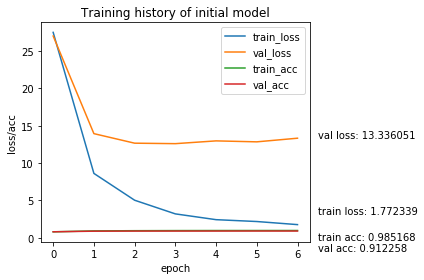

In [9]:
summarize_loss_history(im_history, "Training history of initial model")

#### Loss-Sum-Hinge model (LSH)

We train the model using the SH loss of VSE++.

In [10]:
model_builder = ModelBuilder(text_representation, path_embedding_captions)
trainer = Trainer(text_representation, features, model_builder, loss='sh', mini_batch_size=50)
lsh_history = trainer.train(epochs=40)

loading embeddings from "../datasets/05-caption/glove.twitter.27B.100d.filtered.txt"


Epoch 1: loss: 750.005 accuracy: 0.854 val_loss: 729.591 val_accuracy: 0.855
Epoch 2: loss: 121.561 accuracy: 0.954 val_loss: 237.343 val_accuracy: 0.925
Epoch 3: loss: 55.812 accuracy: 0.976 val_loss: 193.694 val_accuracy: 0.937
Epoch 4: loss: 30.782 accuracy: 0.986 val_loss: 174.909 val_accuracy: 0.943
Epoch 5: loss: 18.848 accuracy: 0.991 val_loss: 170.249 val_accuracy: 0.945
Epoch 6: loss: 12.154 accuracy: 0.994 val_loss: 168.561 val_accuracy: 0.946
Epoch 7: loss: 8.884 accuracy: 0.995 val_loss: 169.96 val_accuracy: 0.946
Epoch 8: loss: 7.142 accuracy: 0.995 val_loss: 173.733 val_accuracy: 0.946
Early stopped at epoch: 9 with loss: 5.046 accuracy: 0.997 val_loss: 172.756 val_accuracy: 0.947


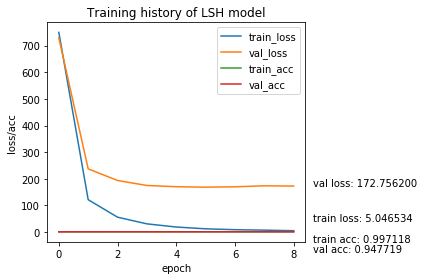

In [11]:
summarize_loss_history(lsh_history, "Training history of LSH model")

#### Loss-Max-Hinge model (LMH)

We train the model using the MH loss of VSE++.

In [12]:
model_builder = ModelBuilder(text_representation, path_embedding_captions)
trainer = Trainer(text_representation, features, model_builder, loss='mh', mini_batch_size=50)
lmh_history = trainer.train(epochs=40)

loading embeddings from "../datasets/05-caption/glove.twitter.27B.100d.filtered.txt"


Epoch 1: loss: 139.623 accuracy: 0.681 val_loss: 140.046 val_accuracy: 0.676
Epoch 2: loss: 56.309 accuracy: 0.847 val_loss: 60.107 val_accuracy: 0.831
Epoch 3: loss: 35.411 accuracy: 0.918 val_loss: 43.919 val_accuracy: 0.893
Epoch 4: loss: 25.402 accuracy: 0.95 val_loss: 38.672 val_accuracy: 0.918
Epoch 5: loss: 20.146 accuracy: 0.965 val_loss: 37.712 val_accuracy: 0.929
Epoch 6: loss: 16.664 accuracy: 0.974 val_loss: 37.876 val_accuracy: 0.933
Epoch 7: loss: 13.594 accuracy: 0.981 val_loss: 37.868 val_accuracy: 0.941
Early stopped at epoch: 8 with loss: 11.089 accuracy: 0.986 val_loss: 38.628 val_accuracy: 0.946


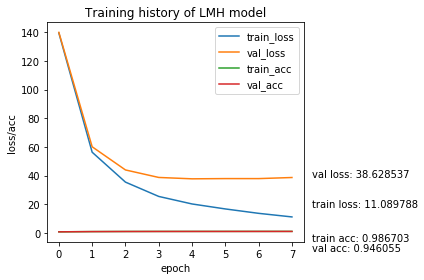

In [13]:
summarize_loss_history(lmh_history, "Training history of LMH model")

### Performances

### Caption retreival

We select a few images of different topics from the *COCO_val2014* dataset.

In [14]:
image_names = ['COCO_val2014_000000004554.jpg', 'COCO_val2014_000000000428.jpg', 'COCO_val2014_000000012966.jpg', \
    'COCO_val2014_000000134193.jpg', 'COCO_val2014_000000175197.jpg', 'COCO_val2014_000000220344.jpg', \
    'COCO_val2014_000000218456.jpg', 'COCO_val2014_000000209419.jpg', 'COCO_val2014_000000125228.jpg', \
    'COCO_val2014_000000089271.jpg']
image_path = ProjectPaths.datasets_path + os.sep + '05-caption-images'

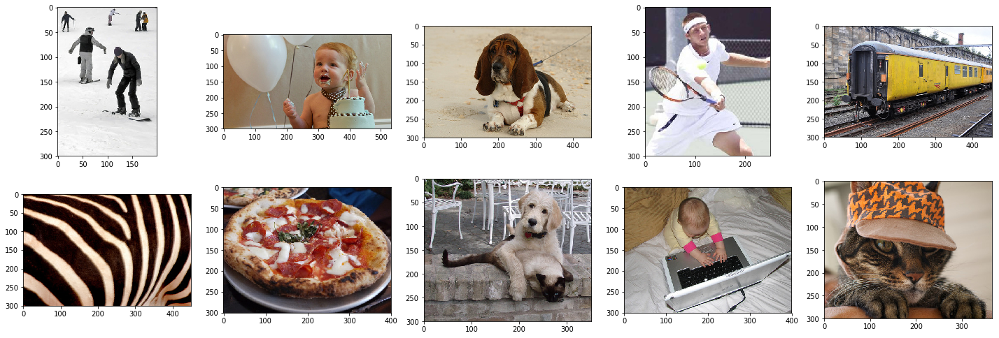

In [15]:
plot_image_array(image_path, image_names)

We use the `CaptionRetreival` class in order to compute the 3 most likely captions for each image. The model used is the one trained with SH loss of VSE++.

In [ ]:
caption_retreival_results = dict()
for image_name in image_names:
    caption_retreival = CaptionRetreival.load(
        text_representation_path=ProjectPaths.text_representation_path,
        image_model_path=ProjectPaths.image_model_path,
        caption_model_path=ProjectPaths.image_model_path,
        vocab_path=ProjectPaths.vocab_path,
        caption_representations_path=ProjectPaths.caption_representations_name + '.npy'
    )
    caption_retreival_results[image_name] = caption_retreival.generate_caption(image_path + os.sep + image_name, n=3)

We plot the following images with their corresponding captions.

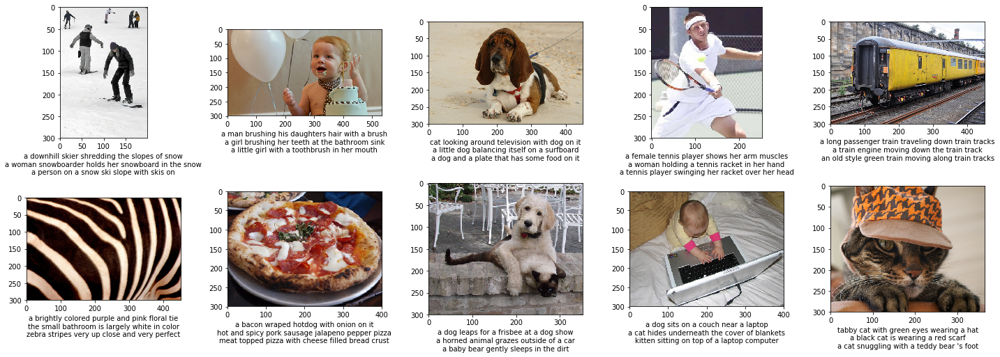

In [81]:
plot_image_array(image_path, image_names, caption_retreival_results)

### Image retreival

We want now to compute the opposite operation: retreive the most likely images from a caption.

In [30]:
image_retreival = ImageRetreival.load(
    caption_model_path=ProjectPaths.caption_model_path,
    image_representation_path=ProjectPaths.image_representations_name + '.npy',
    text_representation_path=ProjectPaths.text_representation_path,
    vocab_path=ProjectPaths.vocab_path
)

image_retreival_results = image_retreival.search_image('a man skiing by himself through the snow')

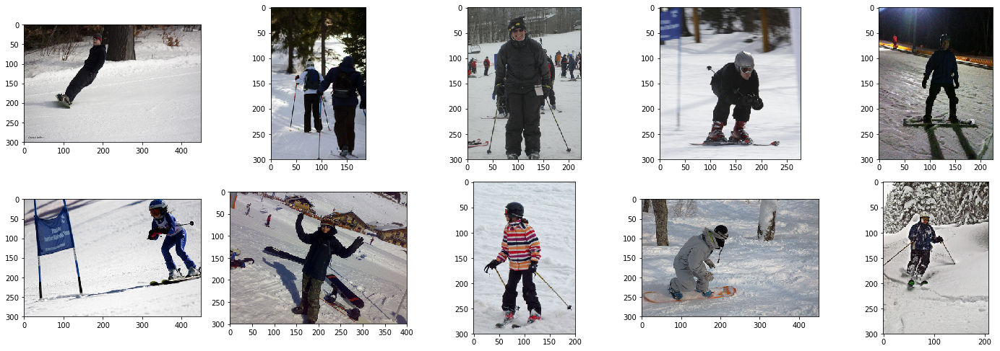

In [35]:
plot_image_array(image_path, [image_name for _, image_name in image_retreival_results])

## t-SNE

In order to better resolve the connections between the different features of our dataset, we can plot the images and/or the captions in a scatter in 2D/3D.

We load the representations.

In [ ]:
image_activations = np.load(ProjectPaths.image_representations_name + '.npy')
caption_activations = np.load(ProjectPaths.caption_representations_name + '.npy')
text_representation = TextRepresentation(ProjectPaths.text_representation_path)

### Representation of the images in a 2D scatter

In [ ]:
tsne_image_2d_scatter_ = TSNEImage2DScatter(ProjectPaths.datasets_path + os.sep + '05-caption-images', image_activations)
tsne_image_2d_scatter_.generate()

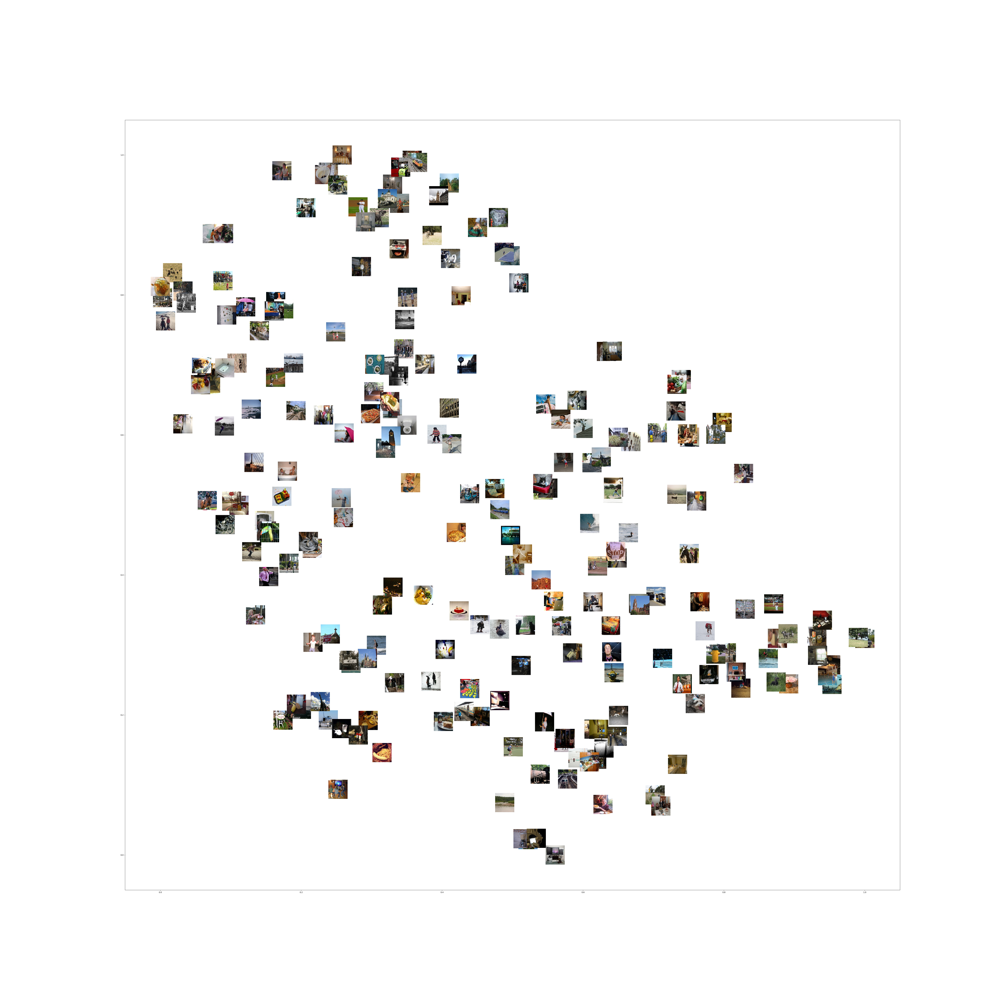

In [11]:
Image(filename='..' + os.sep + 'tsne_images' + os.sep + 'tsne_image_2d_scatter_lsh-0-95.jpg')

### Representation of the captions in a 2D scatter

In [ ]:
tsne_caption_2d_scatter = TSNECaption2DScatter(caption_activations, text_representation)
tsne_caption_2d_scatter.generate()

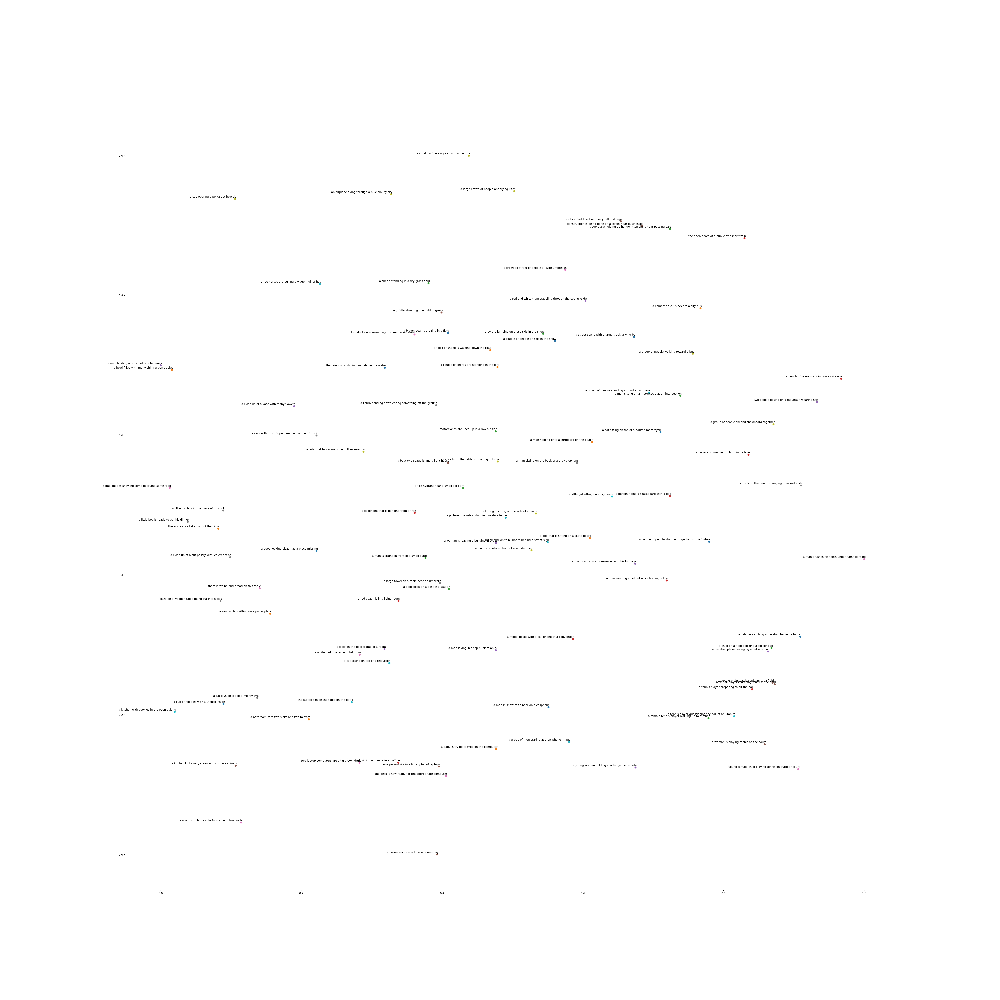

In [12]:
Image(filename='..' + os.sep + 'tsne_images' + os.sep + 'tsne_caption_2d_scatter_lsh-0-95.jpg')

### Representation of the captions in a 3D scatter

In [ ]:
tsne_caption_3d_scatter = TSNECaption3DScatter(caption_activations, text_representation)
tsne_caption_3d_scatter.generate()

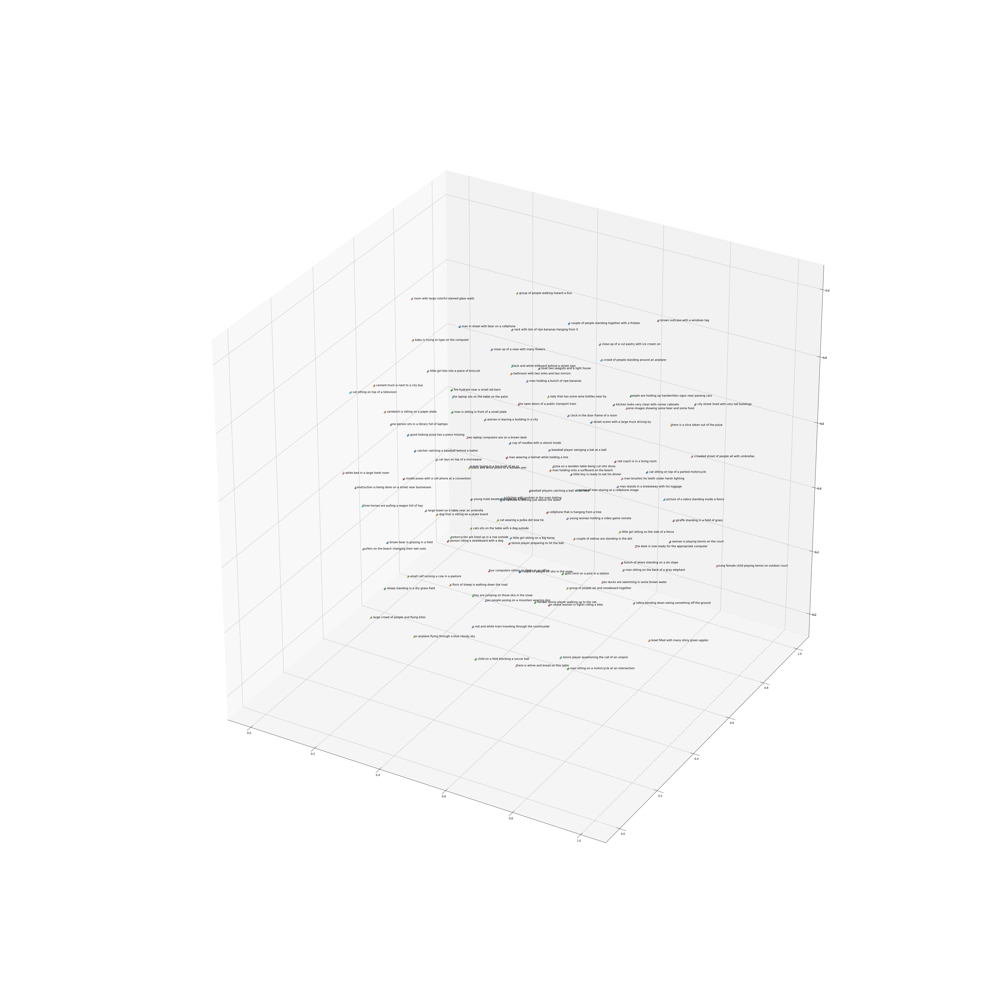

In [13]:
Image(filename='..' + os.sep + 'tsne_images' + os.sep + 'tsne_caption_3d_scatter_lsh-0-95.jpg')

### Representation of the images and the corresponding captions in a 2D scatter

In [ ]:
tsne_image_caption_2d_scatter = TSNEImageCaption2DScatter(
    input_directory=ProjectPaths.datasets_path + os.sep + '05-caption-images',
    image_activations=image_activations,
    caption_activations=caption_activations,
    image_model=load_model(ProjectPaths.image_model_path),
    feature_model=ResNet50(weights='imagenet', include_top=False, pooling='avg'),
    text_representation=text_representation
)
tsne_image_caption_2d_scatter.generate()

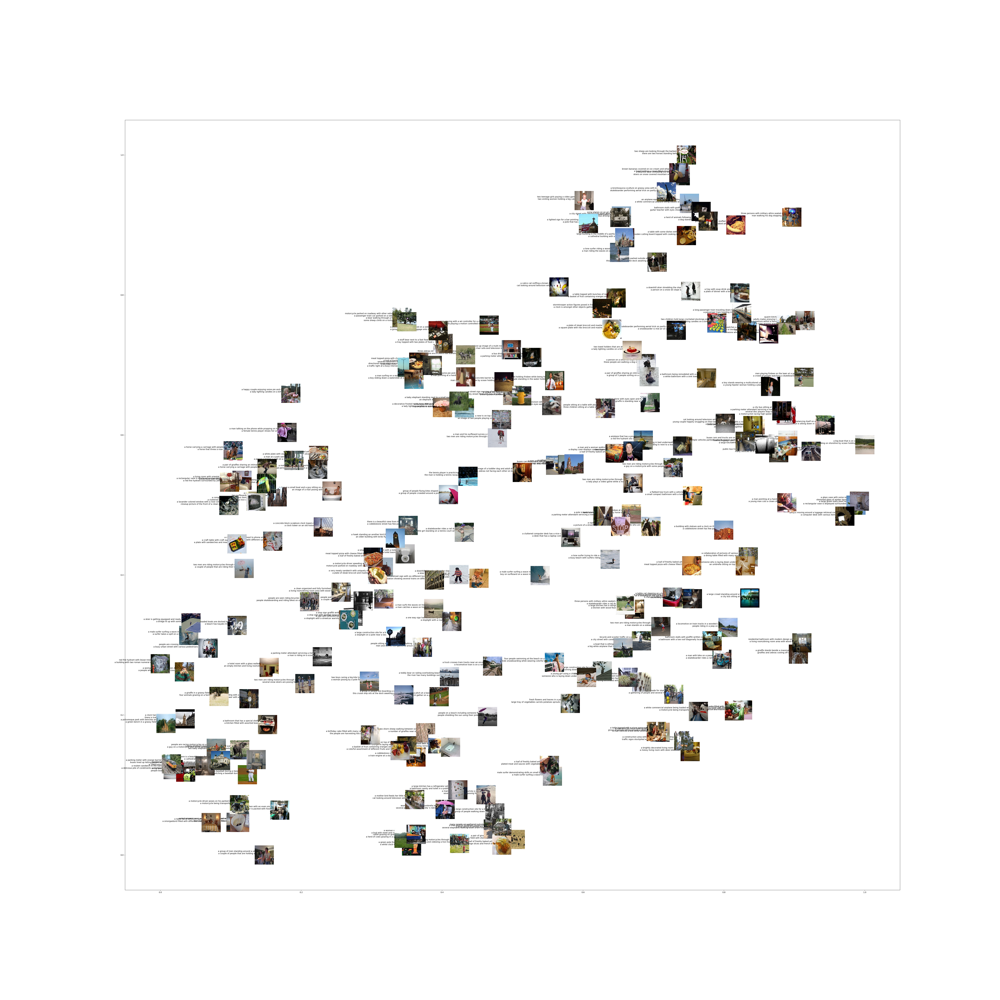

In [14]:
Image(filename='..' + os.sep + 'tsne_images' + os.sep + 'tsne_image_caption_2d_scatter_lsh-0-95.jpg')